# Машинное обучение, ФКН ВШЭ

## Практическое задание 2. Exploratory Data Analysis и линейная регрессия

### Общая информация
Дата выдачи: 05.10.2023

Мягкий дедлайн: 23:59MSK 18.10.2023

Жесткий дедлайн: 23:59MSK 22.10.2022

### О задании
В этом задании мы попытаемся научиться анализировать данные и выделять из них полезные признаки. Мы также научимся пользоваться `seaborn` и `sklearn`, а заодно привыкнем к основным понятиям машинного обучения.

### Оценивание и штрафы
Каждая из задач имеет определенную «стоимость» (указана в скобках около задачи). Максимально допустимая оценка за работу — 10 баллов. Проверяющий имеет право снизить оценку за неэффективную реализацию или неопрятные графики.

**Обратите внимание**, что в каждом разделе домашнего задания есть оцениваниемые задачи и есть вопросы. Вопросы дополняют задачи и направлены на то, чтобы проинтерпретировать или обосновать происходящее. Код без интерпретации не имеет смысла, поэтому отвечать на вопросы обязательно — за отсутствие ответов мы будем снижать баллы за задачи. Если вы ответите на вопросы, но не напишете корректный код к соответствующим оцениваемым задачам, то баллы за такое выставлены не будут.

Сдавать задание после указанного срока сдачи нельзя. При выставлении неполного балла за задание в связи с наличием ошибок на усмотрение проверяющего предусмотрена возможность исправить работу на указанных в ответном письме условиях.

Задание выполняется самостоятельно. «Похожие» решения считаются плагиатом и все задействованные студенты (в том числе те, у кого списали) не могут получить за него больше 0 баллов (подробнее о плагиате см. на странице курса). Если вы нашли решение какого-то из заданий (или его часть) в открытом источнике, необходимо указать ссылку на этот источник в отдельном блоке в конце вашей работы (скорее всего вы будете не единственным, кто это нашел, поэтому чтобы исключить подозрение в плагиате, необходима ссылка на источник).

### Формат сдачи
Задания сдаются через систему Anytask. Инвайт можно найти на странице курса. Присылать необходимо ноутбук с выполненным заданием. Сам ноутбук называйте в формате homework-practice-02-linregr-Username.ipynb, где Username — ваша фамилия.

Для удобства проверки самостоятельно посчитайте свою максимальную оценку (исходя из набора решенных задач) и укажите ниже.

Оценка: 9.

В этом ноутбуке используется библиотека `folium` для визуализации карт. Она работает в google colab!

In [2]:
# !pip install folium

In [3]:
import folium

m = folium.Map(location=(55.7522200, 37.6155600), zoom_start=10)

m

Если вы всё сделали правильно, то выше должна открыться карта Москвы.

In [4]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import sklearn

%matplotlib inline

sns.set(style="darkgrid")
    
np.random.seed(0)

## Часть 0. Подготовка (1 балл)

**Задание 1 (1 балл)**. Мы будем работать с данными из соревнования [New York City Taxi Trip Duration](https://www.kaggle.com/c/nyc-taxi-trip-duration/overview), в котором нужно было предсказать длительность поездки на такси. Скачайте обучающую выборку из этого соревнования и загрузите ее:

In [5]:
train = pd.read_csv('train.csv')
test = pd.read_csv('test.csv')
submission = pd.read_csv('sample_submission.csv')

Обратите внимание на колонки `pickup_datetime` и `dropoff_datetime`. `dropoff_datetime` был добавлена организаторами только в обучающую выборку, то есть использовать эту колонку нельзя, давайте удалим ее. В `pickup_datetime` записаны дата и время начала поездки. Чтобы с ней было удобно работать, давайте преобразуем даты в `datetime`-объекты

In [6]:
train.drop(columns = ['dropoff_datetime'],inplace = True)
train['pickup_datetime']= pd.to_datetime(train['pickup_datetime'])
test['pickup_datetime']= pd.to_datetime(test['pickup_datetime'])

В колонке `trip_duration` записано целевое значение, которое мы хотим предсказывать. Давайте посмотрим на распределение таргета в обучающей выборке. Для этого нарисуйте его гистограмму:

In [7]:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

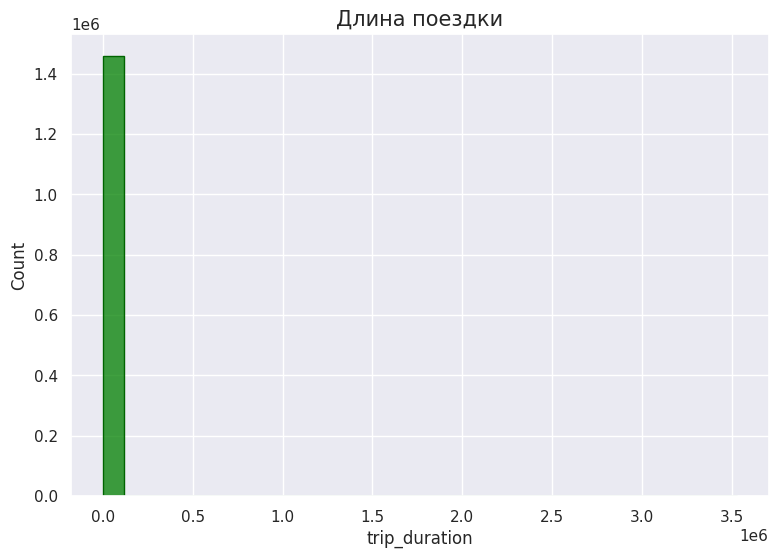

In [8]:
fig, ax = plt.subplots(figsize=(9, 6))
ax.set_title('Длина поездки', fontsize=15)
sns.histplot(train.trip_duration,
             bins=30,
             ax=ax, 
             color='green',
             edgecolor='darkgreen');

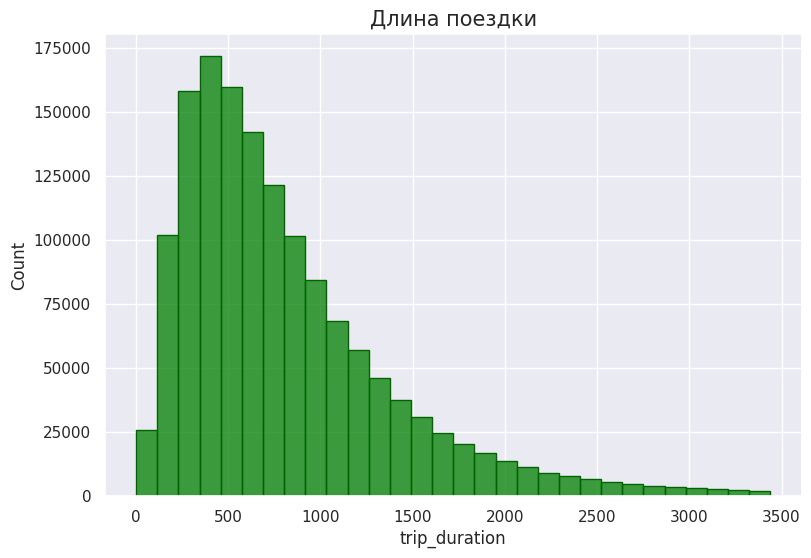

In [9]:
no_out =  train[train['trip_duration'] < train['trip_duration'].quantile(q=0.99)] # без выбросов
fig, ax = plt.subplots(figsize=(9, 6))
ax.set_title('Длина поездки', fontsize=15)
sns.histplot(no_out.trip_duration,
             bins=30,
             ax=ax, 
             color='green',
             edgecolor='darkgreen');

In [10]:
train['trip_duration'].max()

3526282

**Вопрос**: Что можно сказать о целевой переменной по гистограмме её значений?

Есть сильные выбросы вправо, возможно, ошибка ввода. Если построить гистограмму по значениям до 99 перцентиля, то можно увидеть распределение. Максимум достигается в районе 500 сек, имеется хвост вправо.

В соревновании в качестве метрики качества использовалось RMSLE:
$$\text{RMSLE}(X, y, a) = \sqrt{\frac{1}{\ell}\sum_{i=1}^{\ell} \big(\log{(y_i + 1)} - \log{(a(x_i) + 1)}\big)^2}$$

**Вопрос**: Как вы думаете, почему авторы соревнования выбрали именно RMSLE, а не RMSE?

In [11]:
def rmsle_one_obj(y_true, y_pred):
    loss = np.square(np.log1p(y_pred) - np.log1p(y_true))
    return loss

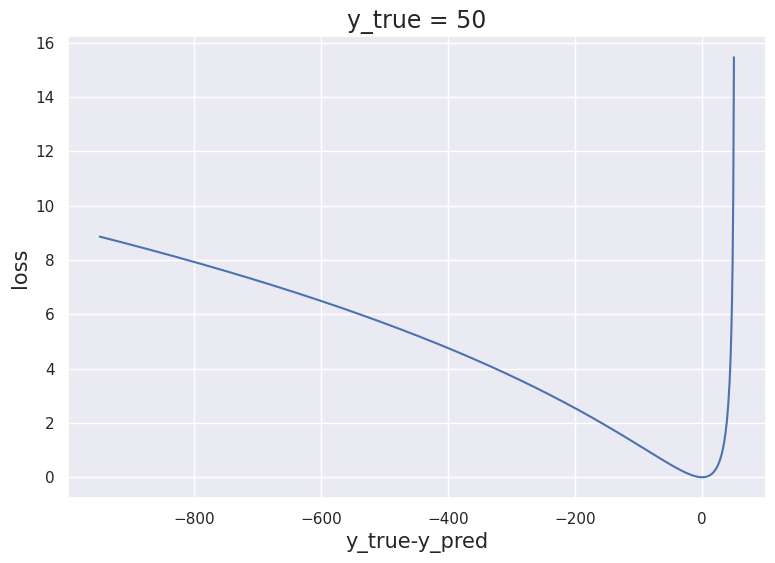

In [12]:
rmsle = []
delta = []
y_true = 50
for y_pred in range(0, 1000):
    rmsle.append(rmsle_one_obj(y_true, y_pred))
    delta.append(y_true-y_pred)
plt.figure(figsize = (9, 6))
plt.plot(delta, rmsle, label = 'rmsle')
plt.title(f'y_true = {y_true}', fontsize=17)
plt.xlabel('y_true-y_pred', fontsize=15)
plt.ylabel('loss', fontsize=15)
plt.show()

Возможно, из-за того, что лучше предсказывать заниженное время поездки, чем завышенное. Люди могут планировать успеть на какую-то встречу и закладывать на поездку предсказанное время. Если истинное время меньше, пользователи будут просто опаздывать на встречу.\
RMSLE не симметричная. Выше на картинке видно штраф на одном объекте. Истинное время поездки - 50 секунд. Штраф за то, чтобы предсказывать 1 секунду больше, чем штраф за то, чтобы предсказывать 1000 секунд. 

На семинаре мы рассматривали несколько моделей линейной регрессии в `sklearn`, но каждая из них оптимизировала среднеквадратичную ошибку (MSE), а не RMSLE. Давайте проделаем следующий трюк: будем предсказывать не целевую переменную, а ее *логарифм*. Обозначим $\hat{y}_i = \log{(y_i + 1)}$ — модифицированный таргет, а $\hat{a}(x_i)$ — предсказание модели, которая обучалась на $\hat{y}_i$, то есть логарифм таргета. Чтобы предсказать исходное значение, мы можем просто взять экспоненту от нашего предсказания: $a(x_i) = \exp(\hat{a}(x_i)) - 1$.

**Вопрос**: Покажите, что оптимизация RMSLE для модели $a$ эквивалентна оптимизации MSE для модели $\hat{a}$.

**Доказательство**:

Итак, мы смогли свести задачу оптимизации RMSLE к задаче оптимизации MSE, которую мы умеем решать! Кроме того, у логарифмирования таргета есть еще одно полезное свойство. Чтобы его увидеть, добавьте к нашей выборке колонку `log_trip_duration` (воспользуйтесь `np.log1p`) и нарисуйте гистограмму модифицированного таргета по обучающей выборке. Удалите колонку со старым таргетом.

In [13]:
train['log_trip_duration'] = train['trip_duration'].apply(np.log1p)

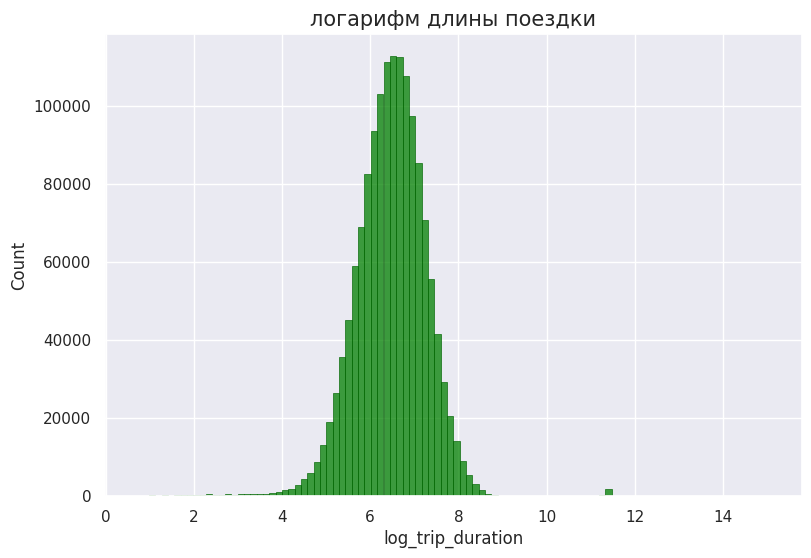

In [14]:
fig, ax = plt.subplots(figsize=(9, 6))
ax.set_title('логарифм длины поездки', fontsize=15)
sns.histplot(train.log_trip_duration,
             bins=100,
             ax=ax, 
             color='green',
             edgecolor='darkgreen');

Теперь все красиво. В целом распределение разумное, продолжительность поездки находится примерно в следующем интервале: 


In [15]:
print("В секундах:", np.exp(5), np.exp(9))
print("В минутах:", np.exp(5) // 60, np.exp(9) // 60)

В секундах: 148.4131591025766 8103.083927575384
В минутах: 2.0 135.0


Чтобы иметь некоторую точку отсчета, давайте посчитаем значение метрики при наилучшем константном предсказании:

In [16]:
def rmsle(log1p_y_true, log1p_y_pred): 
    return np.sqrt(np.sum((log1p_y_true - log1p_y_pred)**2)/len(log1p_y_pred))
#Минимум достигается на среднем выборочном
rmsle_best_const = rmsle(train['log_trip_duration'], train['log_trip_duration'].mean()*np.ones(train['log_trip_duration'].shape))
print(rmsle_best_const)
assert np.allclose(rmsle_best_const, 0.79575, 1e-4)

0.7957592365411509


## Часть 1. Изучаем `pickup_datetime` (2 балла)

**Задание 2 (0.25 баллов)**. Для начала давайте посмотрим, сколько всего было поездок в каждый из дней. Постройте график зависимости количества поездок от дня в году (например, можно воспользоваться `sns.countplot`):

In [17]:
train['date'] = train.loc[:,'pickup_datetime'].dt.date

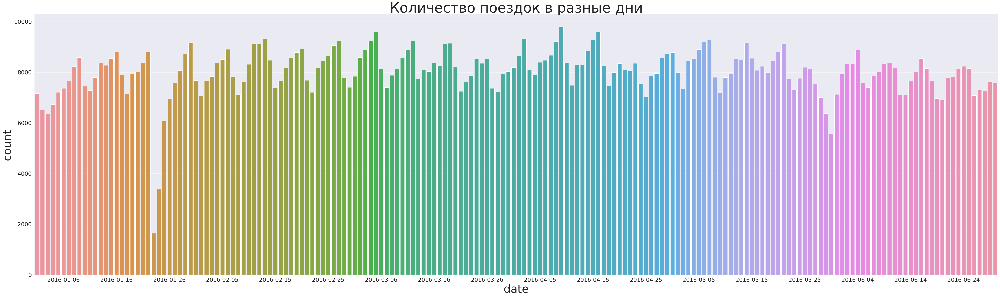

In [18]:
plt.figure(figsize=(50,15))
sns.countplot(data = train, x = 'date', order = np.sort(train['date'].unique()))
plt.xticks(ticks = np.arange(5, 182, 10),fontsize = 20)
plt.yticks(fontsize = 20)
plt.xlabel('date', fontsize = 40)
plt.ylabel('count', fontsize = 40)
plt.title('Количество поездок в разные дни', fontsize = 50)
plt.tight_layout()
plt.show()

Видна недельная сезонность + просадки в некоторые дни

**Вопрос**: Вы, вероятно, заметили, что на графике есть 2 периода с аномально маленькими количествами поездок. Вычислите, в какие даты происходили эти скачки вниз и найдите информацию о том, что происходило в эти дни в Нью-Йорке.

Нарисуйте графики зависимости количества поездок от дня недели и от часов в сутках (воспользуйтесь `sns.relplot`):

In [19]:
train['date'].value_counts().tail(10)

date
2016-01-26    6941
2016-06-20    6910
2016-01-04    6725
2016-01-02    6512
2016-05-29    6372
2016-01-03    6353
2016-01-25    6084
2016-05-30    5570
2016-01-24    3383
2016-01-23    1648
Name: count, dtype: int64

23 и 24 января 2016 в Нью-Йорке были адские снегопады и метель, все сидели дома:)\
29, 30 мая были смерчи

In [20]:
# train['day_name'] = train.loc[:,'pickup_datetime'].dt.day_name()
train['day_of_week'] = train.loc[:,'pickup_datetime'].dt.day_of_week
train['hour'] = train.loc[:,'pickup_datetime'].dt.hour

In [21]:
#считаем количество поездок в каждый день, чтобы посмотреть разброс количества поездок на графике relplot
tmp_df = train.groupby(['date', 'day_of_week'], as_index = False).agg({'date':'count'})

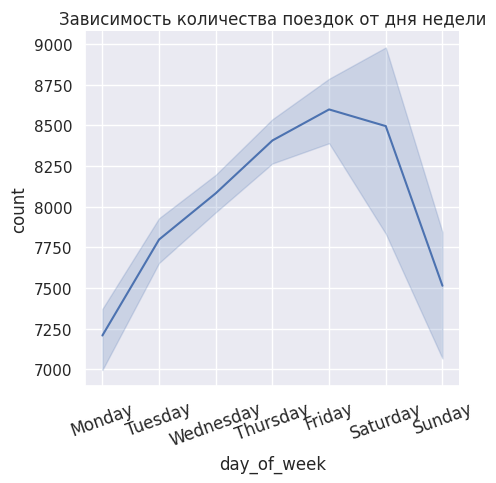

In [22]:
ax = sns.relplot(x='day_of_week',
            y='date',
            kind='line',
            data=tmp_df);
plt.xticks(np.arange(7),
           labels=['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'],
           fontsize=12,
           rotation=20)
plt.ylabel('count')
plt.title('Зависимость количества поездок от дня недели')
plt.tight_layout()
plt.show()

In [23]:
#считаем количество поездок в каждый день в каждый час, чтобы посмотреть разброс количества поездок на графике relplot
tmp_df1 = train.groupby(['date', 'hour'], as_index = False).agg({'date':'count'})

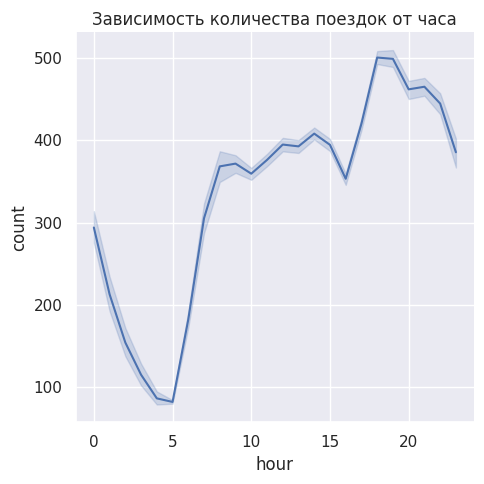

In [24]:
ax = sns.relplot(x='hour',
            y='date',
            kind='line',
            data=tmp_df1)
plt.ylabel('count')
plt.title('Зависимость количества поездок от часа')
plt.tight_layout()
plt.show()

**Задание 3 (0.5 баллов)**. Нарисуйте на одном графике зависимости количества поездок от часа в сутках для разных месяцев (разные кривые, соответствующие разным месяцам, окрашивайте в разные цвета, воспользуйтесь `hue` в `sns.relplot`). Аналогично нарисуйте зависимости количества поездок от часа в сутках для разных дней недели.

In [25]:
train['month'] = train.loc[:,'pickup_datetime'].dt.month
tmp_df2 = train.groupby(['date', 'hour', 'month'], as_index = False).agg({'date':'count'})

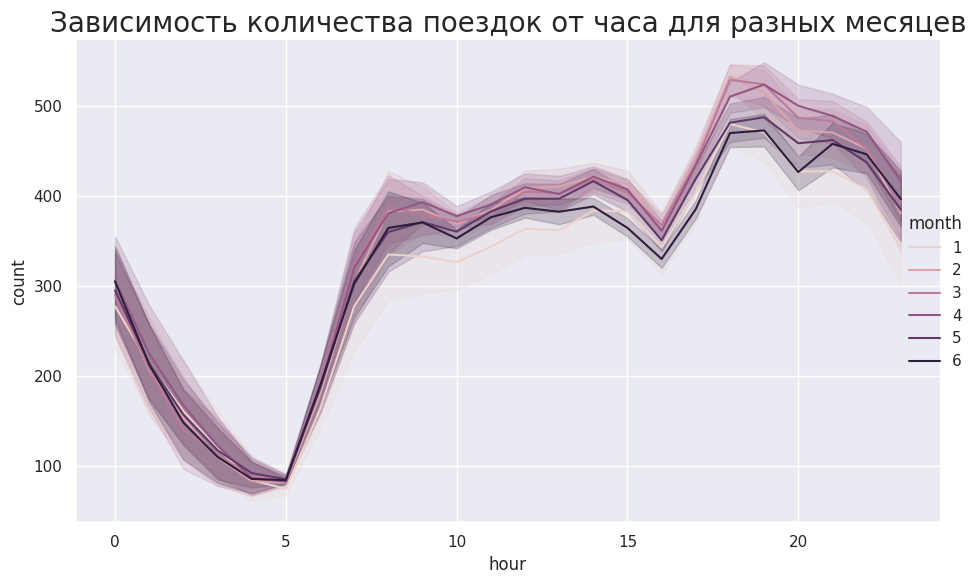

In [26]:
ax = sns.relplot(x='hour',
            y='date',
            kind='line',
            hue = 'month',
            height=6,
            aspect=1.5,
           # ci = None, # перекрываются графики и ничего не видно
            data=tmp_df2)
plt.ylabel('count')
plt.title('Зависимость количества поездок от часа для разных месяцев', fontsize = 20)
plt.tight_layout()
plt.show()

**Вопрос**: Какие выводы можно сделать, основываясь на графиках выше? Выделяются ли какие-нибудь дни недели? Месяца? Время суток? С чем это связано?

Количество поездок нарастает до пятницы, потом спадает. Максимум в пятницу, субботу. В целом, логично, количество может быть большим из-за того, что в эти дни люди выбираются в рестораны/бары и домой легче заказать такси.\
По часам: логично, что выделяются 18, 19, 20, тк в это время людм едут домой с работы. Также логично, что в ночь количество поездок снижается, тк все спят.\
От месяца количество поездок как будто не зависит: доверительные интервалы перекрываются.

**Задание 4 (0.5 баллов)**. Разбейте выборку на обучающую и тестовую в отношении 7:3 (используйте `train_test_split` из `sklearn`). По обучающей выборке нарисуйте график зависимости среднего логарифма времени поездки от дня недели. Затем сделайте то же самое, но для часа в сутках и дня в году.

In [27]:
from sklearn.model_selection import train_test_split #это же и так train?
tr_data, test_data = train_test_split(train, test_size=0.3, random_state=42)

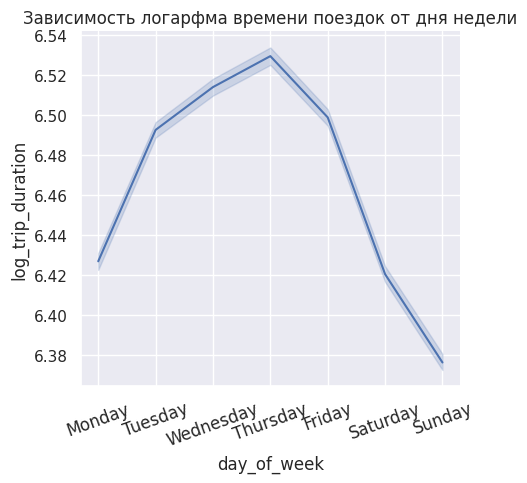

In [28]:
ax = sns.relplot(x='day_of_week',
            y='log_trip_duration',
            kind='line',
            data=tr_data);
plt.xticks(np.arange(7),
           labels=['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'],
           fontsize=12,
           rotation=20)
plt.title('Зависимость логарфма времени поездок от дня недели')
plt.tight_layout()
plt.show()

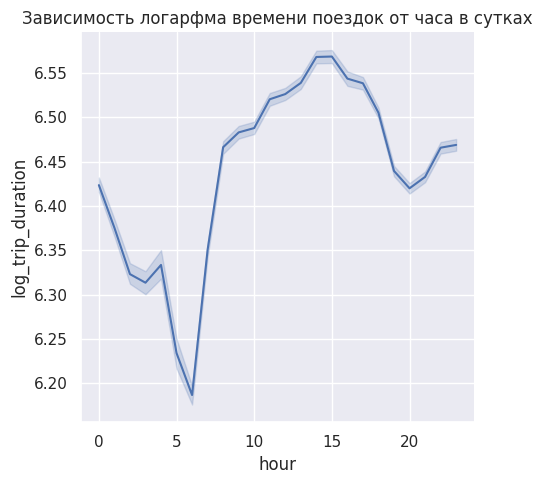

In [29]:
ax = sns.relplot(x='hour',
            y='log_trip_duration',
            kind='line',
            data=tr_data);
plt.title('Зависимость логарфма времени поездок от часа в сутках')
plt.tight_layout()
plt.show()

In [30]:
import datetime
first = datetime.datetime(2016, 1, 1)
tr_data['days_from_first'] = (tr_data['pickup_datetime']-first).dt.days

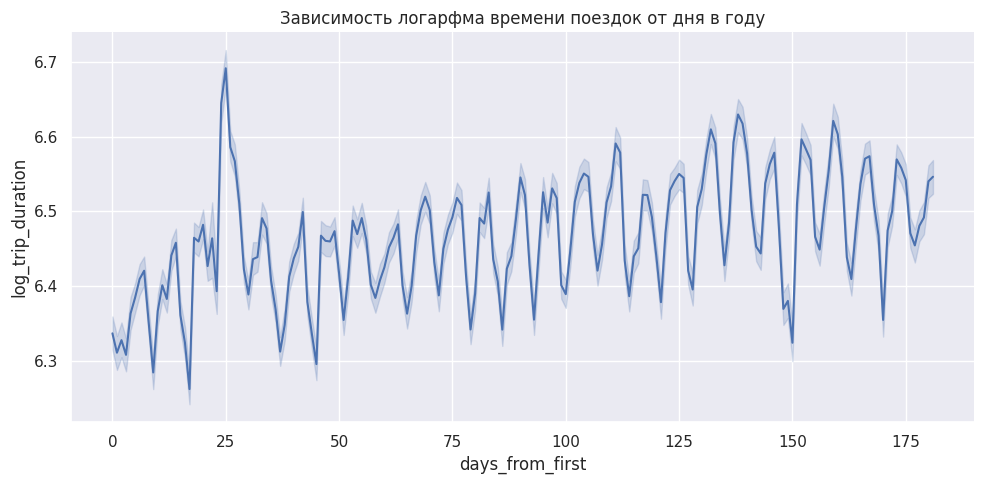

In [31]:
ax = sns.relplot(x='days_from_first',
            y='log_trip_duration',
            kind='line',
            data=tr_data, height = 5, aspect = 2);
plt.title('Зависимость логарфма времени поездок от дня в году')
plt.tight_layout()
plt.show()

Есть тренд на увеличение длины поездок + недельная сезонность

**Вопрос**: Похожи ли графики зависимости таргета от дня недели и от часа в сутках на аналогичные графики для количества поездок? Почему? Что происходит со средним таргетом в те два аномальных периода, что мы видели выше? Почему так происходит? Наблюдаете ли вы какой-нибудь тренд на графике зависимости `log_trip_duration` от номера дня в году?

График зависимости таргета от часа в сутках похож по форме на график зависимости количества поездок от часа в сутках. Оно и понятно - в ночное время поездок и меньше и они менее длительные(никто не хочет далеко ездить ночью), а днем поездок больше и люди готовы преодолевать большие расстояния.

Добавьте следующие признаки на основе `pickup_datetime`:
1. День недели
2. Месяц
3. Час
4. Является ли период аномальным (два бинарных признака, соответствующие двум аномальным периодам)
5. Номер дня в году

In [32]:
test_data['days_from_first'] = (test_data['pickup_datetime']-first).dt.days

In [33]:
may_days = tr_data[(tr_data['days_from_first']==5*30) | (tr_data['days_from_first']==5*30-1)].index
jan_days = tr_data[(tr_data['days_from_first']==23) | (tr_data['days_from_first']==24)].index
tr_data['is_abnormal_1']= tr_data.shape[0]*0
tr_data['is_abnormal_2']= tr_data.shape[0]*0
tr_data.loc[may_days,'is_abnormal_2'] = 1
tr_data.loc[jan_days,'is_abnormal_1'] = 1

In [34]:
may_days = test_data[(test_data['days_from_first']==5*30) | (test_data['days_from_first']==5*30-1)].index
jan_days = test_data[(test_data['days_from_first']==23) | (test_data['days_from_first']==24)].index
test_data['is_abnormal_1']= test_data.shape[0]*0
test_data['is_abnormal_2']= test_data.shape[0]*0
test_data.loc[may_days,'is_abnormal_2'] = 1
test_data.loc[jan_days,'is_abnormal_1'] = 1

In [35]:
tr_data['day'] = tr_data['pickup_datetime'].dt.day
test_data['day'] = test_data['pickup_datetime'].dt.day

In [36]:
# tr_data.drop(columns = ['trip_duration', 'id'], inplace = True)
# test_data.drop(columns = ['trip_duration', 'id'], inplace = True)

In [37]:
assert all(test_data.columns == tr_data.columns)

Итак, мы уже создали некоторое количество признаков.

**Вопрос**: Какие из признаков _стоит рассматривать в этой задаче_   как категориальные, а какие - как численные? Почему?

In [38]:
tr_data.columns

Index(['id', 'vendor_id', 'pickup_datetime', 'passenger_count',
       'pickup_longitude', 'pickup_latitude', 'dropoff_longitude',
       'dropoff_latitude', 'store_and_fwd_flag', 'trip_duration',
       'log_trip_duration', 'date', 'day_of_week', 'hour', 'month',
       'days_from_first', 'is_abnormal_1', 'is_abnormal_2', 'day'],
      dtype='object')

'is_abnormal_1', 'is_abnormal_2', 'day_of_week', 'month', 'hour', 'passenger_count', store_and_fwd_flag - категориальные\
'days_from_first' - численный(много значений)

**Задание 5 (0.75 баллов)**. Обучите `Ridge`-регрессию с параметрами по умолчанию, закодировав все категориальные признаки с помощью `OneHotEncoder`. Численные признаки отмасштабируйте с помощью `StandardScaler`. Используйте только признаки, которые мы выделили в этой части задания.

In [39]:
from sklearn import linear_model
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.metrics  import mean_squared_error 

In [40]:
X_train = tr_data.drop(['log_trip_duration'], axis = 1)
y_train = tr_data['log_trip_duration']
X_test = test_data.drop(['log_trip_duration'], axis = 1)
y_test = test_data['log_trip_duration']

In [41]:
X_test.columns

Index(['id', 'vendor_id', 'pickup_datetime', 'passenger_count',
       'pickup_longitude', 'pickup_latitude', 'dropoff_longitude',
       'dropoff_latitude', 'store_and_fwd_flag', 'trip_duration', 'date',
       'day_of_week', 'hour', 'month', 'days_from_first', 'is_abnormal_1',
       'is_abnormal_2', 'day'],
      dtype='object')

In [42]:
cols = ['day_of_week', 'hour', 'month', 'days_from_first']
categorical = ['day_of_week', 'hour', 'month']#, 'is_abnormal_1', 'is_abnormal_2']
numeric_features = ['days_from_first']

In [43]:
X_train_regr = X_train[cols]
X_test_regr = X_test[cols]

In [44]:
column_transformer = ColumnTransformer([
    ('ohe', OneHotEncoder(handle_unknown="ignore"), categorical),
    ('scaling', StandardScaler(), numeric_features)
])

pipeline = Pipeline(steps=[
    ('ohe_and_scaling', column_transformer),
    ('regression', linear_model.Ridge())
])

In [45]:
X_test_regr.columns

Index(['day_of_week', 'hour', 'month', 'days_from_first'], dtype='object')

In [46]:
model = pipeline.fit(X_train_regr, y_train)
y_pred_regr = model.predict(X_test_regr)

In [47]:
mean_squared_error(y_pred_regr, y_test, squared=False)

0.7882621902119553

## Часть 2. Изучаем координаты (3 балла)
Мы уже очень хорошо изучили данные о времени начала поездки, давайте теперь посмотрим на информацию о координатах начала и конца поездки. Мы подготовили для вас функцию, которая на карте рисует точки начала или конца поездки. Примеры ее вызова вы найдете ниже. Обратите внимание, что в эту функцию мы передаем лишь небольшой кусочек данных, посколько иначе функция будет работать очень долго

In [48]:
def show_circles_on_map(data, latitude_column, longitude_column, color):
    """
    The function draws map with circles on it.
    The center of the map is the mean of coordinates passed in data.
    
    data: DataFrame that contains columns latitude_column and longitude_column
    latitude_column: string, the name of column for latitude coordinates
    longitude_column: string, the name of column for longitude coordinates
    color: string, the color of circles to be drawn
    """

    location = (data[latitude_column].mean(), data[longitude_column].mean())
    m = folium.Map(location=location)

    for _, row in data.iterrows():
        folium.Circle(
            radius=100,
            location=(row[latitude_column], row[longitude_column]),
            color=color,
            fill_color=color,
            fill=True
        ).add_to(m)

    return m

In [49]:
len(X_train)

1021050

In [50]:
show_circles_on_map(X_train.sample(10000), "pickup_latitude", "pickup_longitude", "blue")

In [51]:
show_circles_on_map(X_train.sample(10000), "dropoff_latitude", "dropoff_longitude", "blue")

**Вопрос**: Какие пункты (или скопления точек, в количестве 2-3), по вашему мнению, выделяются на карте от основной массы и могут быть полезны для нашей задачи? Почему вы их выбрали? В чём особенность этих скоплений точек для нашей задачи?

Выделяется группа поездок от аэропортов + от Port Newark Container Terminal

**Задание 6 (0.75 балл)**. Как мы все прекрасно помним, $t = s / v_{\text{ср}}$, поэтому очевидно, что самым сильным признаком будет расстояние, которое необходимо проехать. Мы не можем посчитать точное расстояние, которое необходимо преодолеть такси, но мы можем его оценить, посчитав кратчайшее расстояние между точками начала и конца поездки. Чтобы корректно посчитать расстояние между двумя точками на Земле, можно использовать функцию `haversine`. Также можно воспользоваться кодом с первого семинара. Посчитайте кратчайшее расстояние для объектов и запишите его в колонку `haversine`:

In [52]:
def haversine_array(lat1, lng1, lat2, lng2):
    lat1, lng1, lat2, lng2 = map(np.radians, (lat1, lng1, lat2, lng2))
    AVG_EARTH_RADIUS = 6371  # in km
    lat = lat2 - lat1
    lng = lng2 - lng1
    d = np.sin(lat * 0.5) ** 2 + np.cos(lat1) * np.cos(lat2) * np.sin(lng * 0.5) ** 2
    h = 2 * AVG_EARTH_RADIUS * np.arcsin(np.sqrt(d))
    return h

In [53]:
def dummy_manhattan_distance(lat1, lng1, lat2, lng2):
    a = haversine_array(lat1, lng1, lat1, lng2)
    b = haversine_array(lat1, lng1, lat2, lng1)
    return a + b

In [54]:
X_train.loc[:, 'distance_haversine'] = haversine_array(X_train['pickup_latitude'].values, X_train['pickup_longitude'].values, X_train['dropoff_latitude'].values, X_train['dropoff_longitude'].values)
X_train.loc[:, 'distance_dummy_manhattan'] = dummy_manhattan_distance(X_train['pickup_latitude'].values, X_train['pickup_longitude'].values, X_train['dropoff_latitude'].values, X_train['dropoff_longitude'].values)

X_test.loc[:, 'distance_haversine'] = haversine_array(X_test['pickup_latitude'].values, X_test['pickup_longitude'].values, X_test['dropoff_latitude'].values, X_test['dropoff_longitude'].values)
X_test.loc[:, 'distance_dummy_manhattan'] = dummy_manhattan_distance(X_test['pickup_latitude'].values, X_test['pickup_longitude'].values, X_test['dropoff_latitude'].values, X_test['dropoff_longitude'].values)

Так как мы предсказываем логарифм времени поездки и хотим, чтобы наши признаки были линейно зависимы с этой целевой переменной, нам нужно логарифмировать расстояние: $\log t = \log s - \log{v_{\text{ср}}}$. Запишите логарифм `haversine` в отдельную колонку `log_haversine`:

In [55]:
X_train.loc[:, 'log_distance_haversine'] = X_train.loc[:, 'distance_haversine'].apply(np.log1p)
X_train.loc[:, 'log_distance_dummy_manhattan'] = X_train.loc[:, 'distance_dummy_manhattan'].apply(np.log1p)

In [56]:
X_test.loc[:, 'log_distance_haversine'] = X_test.loc[:, 'distance_haversine'].apply(np.log1p)
X_test.loc[:, 'log_distance_dummy_manhattan'] = X_test.loc[:, 'distance_dummy_manhattan'].apply(np.log1p)

Убедимся, что логарифм расстояния лучше коррелирует с нашим таргетом, чем просто расстояние:

In [57]:
assert X_train['log_distance_haversine'].corr(y_train) > X_train['distance_haversine'].corr(y_train)

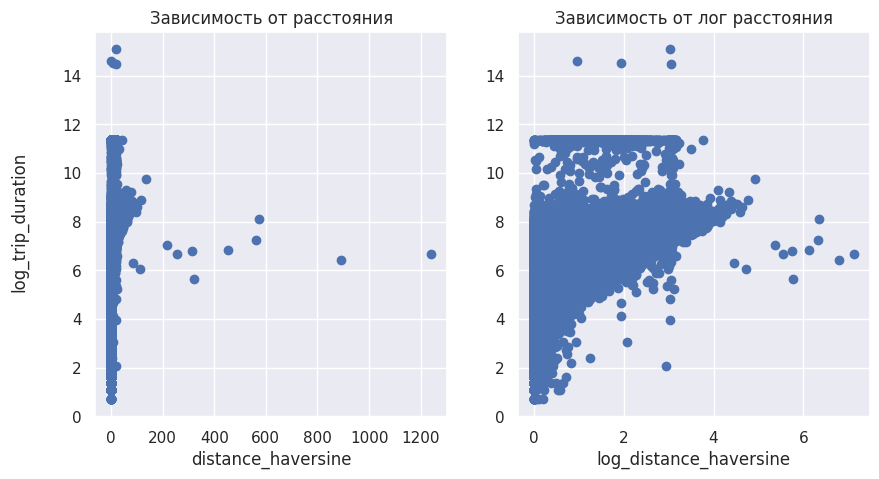

In [58]:
f, (ax1, ax2) = plt.subplots(1, 2, figsize = (10,5))
ax1.scatter(X_train['distance_haversine'], y_train)
ax1.set_xlabel('distance_haversine')
ax1.set_title('Зависимость от расстояния')
ax2.scatter(X_train['log_distance_haversine'], y_train)
ax2.set_xlabel('log_distance_haversine')
ax2.set_title('Зависимость от лог расстояния')
f.text(0.04, 0.5, 'log_trip_duration', va='center', rotation='vertical')
plt.show()

Во втором случае более похоже на линейную зависимость

**Задание 7 (0.75 балла)**. Давайте изучим среднюю скорость движения такси. Посчитайте среднюю скорость для каждого объекта обучающей выборки, разделив `haversine` на `trip_duration`, и нарисуйте гистограмму ее распределения

In [59]:
speed = X_train['distance_haversine']/(tr_data['trip_duration'])

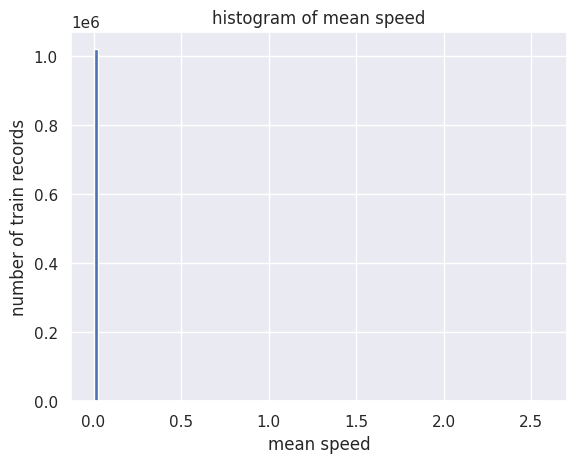

In [60]:
plt.hist(speed, bins=100)
plt.xlabel('mean speed')
plt.ylabel('number of train records')
plt.title('histogram of mean speed')
plt.show()

Как можно видеть по гистограмме, для некоторых объектов у нас получились очень больше значения скоростей. Нарисуйте гистограмму по объектам, для которых значение скорости получилось разумным (например, можно не включать рассмотрение объекты, где скорость больше некоторой квантили):

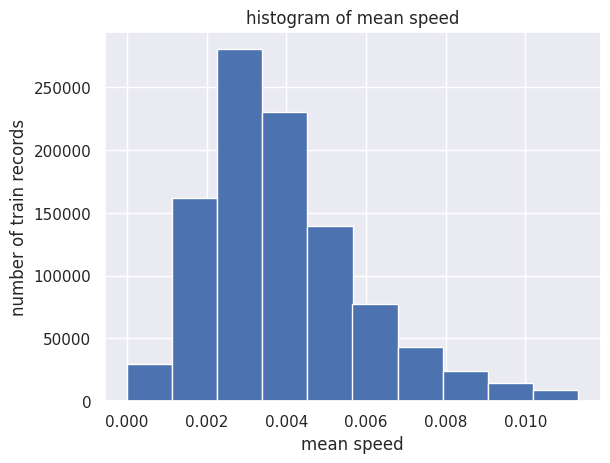

In [61]:
plt.hist(speed, range = (0, speed.quantile(q=0.99)))
plt.xlabel('mean speed')
plt.ylabel('number of train records')
plt.title('histogram of mean speed')
plt.show()

Для каждой пары (день недели, час суток) посчитайте медиану скоростей. Нарисуйте с помощью `sns.heatmap` график, где по осям будут дни недели и часы, а в качестве значения функции - медиана скорости

In [62]:
tmp = X_train.copy()
tmp['velocity'] = X_train['distance_haversine']/(X_train['trip_duration'])

In [63]:
tmp = tmp.groupby(by = ['day_of_week', 'hour'], as_index = False).agg({'velocity':'mean'})
tmp = tmp.pivot(index = "day_of_week",columns = "hour", values = "velocity")

In [64]:
tmp.index = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']

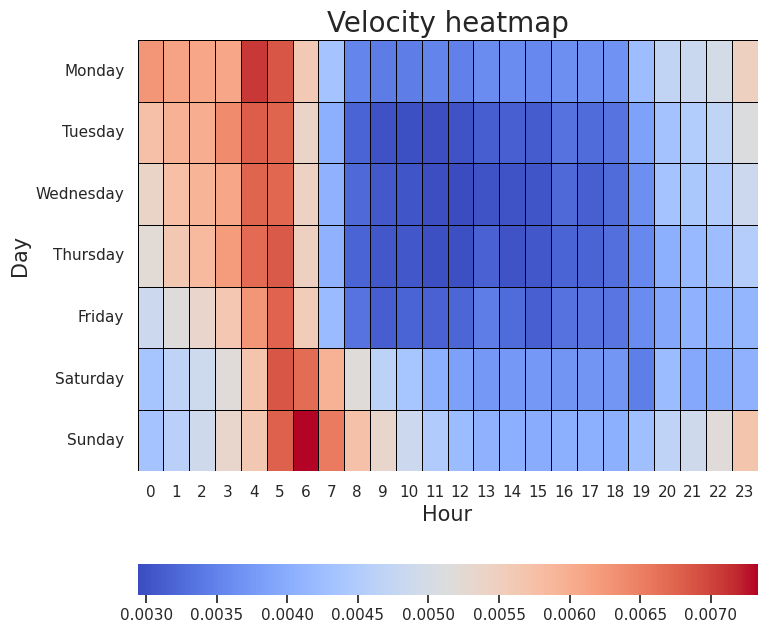

In [65]:
fig, ax = plt.subplots(figsize=(8,8))
sns.heatmap(tmp,  cmap= 'coolwarm', linewidths=0.7, linecolor='black', cbar_kws= {'orientation': 'horizontal'}, ax = ax)
plt.title('Velocity heatmap', fontsize = 20)
plt.xlabel('Hour', fontsize = 15)
plt.ylabel('Day', fontsize = 15)
plt.show()

Не забудьте удалить колонку со значением скорости из данных!

**Вопрос**: Почему значение скорости нельзя использовать во время обучения?

Ее нельзя получить в тестовой выборке

**Вопрос**: Посмотрите внимательно на график и скажите, в какие моменты времени скорость минимальна; максимальна.

Создайте признаки "поездка совершается в период пробок" и "поездка совершается в период свободных дорог" (естественно, они не должен зависеть от скорости!):

In [66]:
X_train['is_jam'] = X_train['hour'].apply(lambda x: 1 if x in range(8,19) else 0)
X_test['is_jam'] = X_test['hour'].apply(lambda x: 1 if x in range(8,19) else 0)

In [67]:
X_train['is_free'] = X_train['hour'].apply(lambda x: 1 if x in range(1,7) else 0)
X_test['is_free'] = X_test['hour'].apply(lambda x: 1 if x in range(1,7) else 0)

In [68]:
#На выходных другое распределение. Да и в целом, думаю, полезно создать признак, является ли день выходным.
# возможно стоило is_jam/is_free делать для каждого дня разное
# X_train['is_weekend'] = X_train['day_of_week'].apply(lambda x: 1 if x in (5,6) else 0)
# X_test['is_weekend'] = X_test['day_of_week'].apply(lambda x: 1 if x in (5,6) else 0)

**Задание 8 (0.25 балла)**. Для каждого из замеченных вами выше 2-3 пунктов добавьте в выборку по два признака: 
- началась ли поездка в этом пункте
- закончилась ли поездка в этом пункте

Как вы думаете, почему эти признаки могут быть полезны?

In [69]:
def show_circles_on_map(data, latitude_column, longitude_column, color):
    """
    The function draws map with circles on it.
    The center of the map is the mean of coordinates passed in data.
    
    data: DataFrame that contains columns latitude_column and longitude_column
    latitude_column: string, the name of column for latitude coordinates
    longitude_column: string, the name of column for longitude coordinates
    color: string, the color of circles to be drawn
    """

    location = (data[latitude_column].mean(), data[longitude_column].mean())
    m = folium.Map(location=location)

    for i, row in data.iterrows():
        folium.Circle(
            radius=100,
            location=(row[latitude_column], row[longitude_column]),
            color=color,
            fill_color=color,
            fill=True
        ).add_child(folium.Popup(str(i))).add_to(m)

    return m

In [70]:
show_circles_on_map(X_train.sample(10000), "pickup_latitude", "pickup_longitude", "blue")

У аэропортов могут быть пробки. При добавлении фичи, что поездка от аэропорта, моделью скорее всего будет добавлены положительная константа.


Найдем координаты прямоугольников, захватывающих аэропорты (на глаз двигаю от крайных точек по выборке, чтобы точно захватить все возможные поезки от аэропорта)

In [71]:
air_1_long_right = X_train.loc[966505]['pickup_longitude'] 
air_1_long_left = X_train.loc[84267]['pickup_longitude'] -0.005
air_1_lat_left = X_train.loc[243509]['pickup_latitude'] 
air_1_lat_right = X_train.loc[239934]['pickup_latitude'] + 0.002

In [72]:
air_2_long_right = X_train.loc[541078]['pickup_longitude'] +0.004
air_2_long_left = X_train.loc[1080675]['pickup_longitude'] 
air_2_lat_left = X_train.loc[1366516]['pickup_latitude'] - 0.003
air_2_lat_right = X_train.loc[267354]['pickup_latitude'] + 0.008

In [73]:
location = (X_train['pickup_latitude'].mean(), X_train['pickup_longitude'].mean())
m = folium.Map(location=location)
folium.Rectangle(bounds = [(air_1_lat_left, air_1_long_left), (air_1_lat_left, air_1_long_right), (air_1_lat_right, air_1_long_left), (air_1_lat_right, air_1_long_right)], color = 'red' ).add_to(m)
folium.Rectangle(bounds = [(air_2_lat_left, air_2_long_left), (air_2_lat_left, air_2_long_right), (air_2_lat_right, air_2_long_left), (air_2_lat_right, air_2_long_right)], color = 'red' ).add_to(m)
m

In [74]:
#говнокод:(
X_train['long_start_in_air1'] = X_train['pickup_longitude'].apply(lambda x: 1 if (x>=air_1_long_left) & (x <= air_1_long_right) else 0)
X_train['lat_start_in_air1'] = X_train['pickup_latitude'].apply(lambda x: 1 if (x>=air_1_lat_left) & (x <= air_1_lat_right) else 0)
X_train['start_in_air1'] = X_train['long_start_in_air1'] & X_train['lat_start_in_air1']
X_train.drop(columns = ['long_start_in_air1', 'lat_start_in_air1'], inplace = True)

X_train['long_end_in_air1'] = X_train['dropoff_longitude'].apply(lambda x: 1 if (x>=air_1_long_left) & (x <= air_1_long_right) else 0)
X_train['lat_end_in_air1'] = X_train['dropoff_latitude'].apply(lambda x: 1 if (x>=air_1_lat_left) & (x <= air_1_lat_right) else 0)
X_train['end_in_air1'] = X_train['long_end_in_air1'] & X_train['lat_end_in_air1']
X_train.drop(columns = ['long_end_in_air1', 'lat_end_in_air1'], inplace = True)

X_train['long_start_in_air2'] = X_train['pickup_longitude'].apply(lambda x: 1 if (x>=air_2_long_left) & (x <= air_2_long_right) else 0)
X_train['lat_start_in_air2'] = X_train['pickup_latitude'].apply(lambda x: 1 if (x>=air_2_lat_left) & (x <= air_2_lat_right) else 0)
X_train['start_in_air2'] = X_train['long_start_in_air2'] & X_train['lat_start_in_air2']
X_train.drop(columns = ['long_start_in_air2', 'lat_start_in_air2'], inplace = True)

X_train['long_end_in_air2'] = X_train['dropoff_longitude'].apply(lambda x: 1 if (x>=air_2_long_left) & (x <= air_2_long_right) else 0)
X_train['lat_end_in_air2'] = X_train['dropoff_latitude'].apply(lambda x: 1 if (x>=air_2_lat_left) & (x <= air_2_lat_right) else 0)
X_train['end_in_air2'] = X_train['long_end_in_air2'] & X_train['lat_end_in_air2']
X_train.drop(columns = ['long_end_in_air2', 'lat_end_in_air2'], inplace = True)

In [75]:
#todo: transformer
X_test['long_start_in_air1'] = X_test['pickup_longitude'].apply(lambda x: 1 if (x>=air_1_long_left) & (x <= air_1_long_right) else 0)
X_test['lat_start_in_air1'] = X_test['pickup_latitude'].apply(lambda x: 1 if (x>=air_1_lat_left) & (x <= air_1_lat_right) else 0)
X_test['start_in_air1'] = X_test['long_start_in_air1'] & X_test['lat_start_in_air1']
X_test.drop(columns = ['long_start_in_air1', 'lat_start_in_air1'], inplace = True)

X_test['long_end_in_air1'] = X_test['dropoff_longitude'].apply(lambda x: 1 if (x>=air_1_long_left) & (x <= air_1_long_right) else 0)
X_test['lat_end_in_air1'] = X_test['dropoff_latitude'].apply(lambda x: 1 if (x>=air_1_lat_left) & (x <= air_1_lat_right) else 0)
X_test['end_in_air1'] = X_test['long_end_in_air1'] & X_test['lat_end_in_air1']
X_test.drop(columns = ['long_end_in_air1', 'lat_end_in_air1'], inplace = True)

X_test['long_start_in_air2'] = X_test['pickup_longitude'].apply(lambda x: 1 if (x>=air_2_long_left) & (x <= air_2_long_right) else 0)
X_test['lat_start_in_air2'] = X_test['pickup_latitude'].apply(lambda x: 1 if (x>=air_2_lat_left) & (x <= air_2_lat_right) else 0)
X_test['start_in_air2'] = X_test['long_start_in_air2'] & X_test['lat_start_in_air2']
X_test.drop(columns = ['long_start_in_air2', 'lat_start_in_air2'], inplace = True)

X_test['long_end_in_air2'] = X_test['dropoff_longitude'].apply(lambda x: 1 if (x>=air_2_long_left) & (x <= air_2_long_right) else 0)
X_test['lat_end_in_air2'] = X_test['dropoff_latitude'].apply(lambda x: 1 if (x>=air_2_lat_left) & (x <= air_2_lat_right) else 0)
X_test['end_in_air2'] = X_test['long_end_in_air2'] & X_test['lat_end_in_air2']
X_test.drop(columns = ['long_end_in_air2', 'lat_end_in_air2'], inplace = True)

In [76]:
(X_train['start_in_air1']).sum(), (X_train['start_in_air2']).sum()

(21292, 25844)

Для каждого из созданных признаков нарисуйте "ящик с усами" (`sns.boxplot`) распределения логарифма времени поездки

In [77]:
cols = ['day_of_week', 'hour', 'month', 'day', 'is_abnormal_1', 'is_abnormal_2', 'is_jam',
       'is_free', 'start_in_air1', 'start_in_air2', 'end_in_air1', 'end_in_air2']

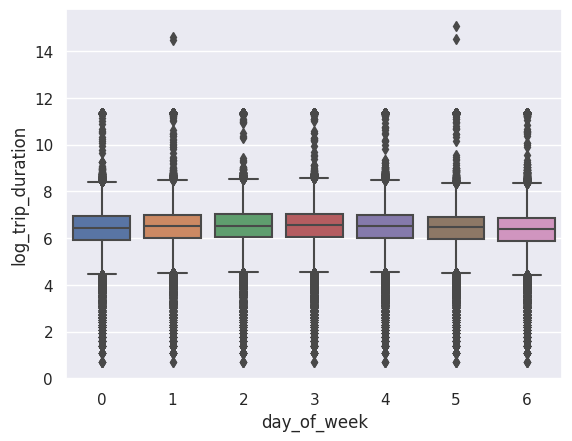

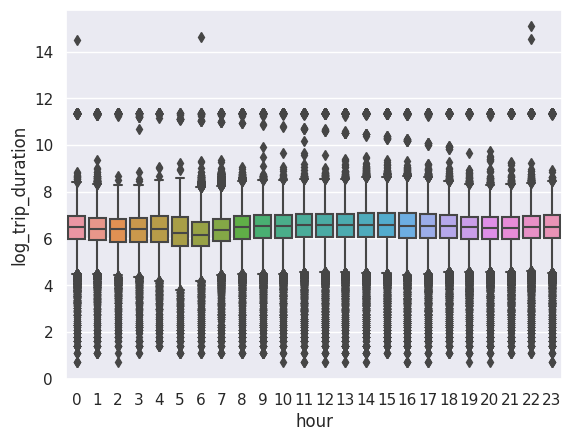

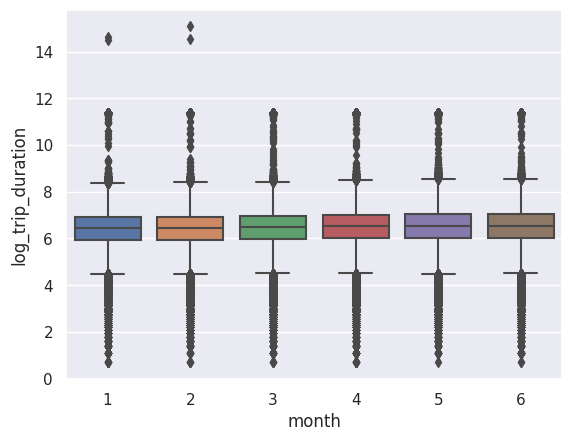

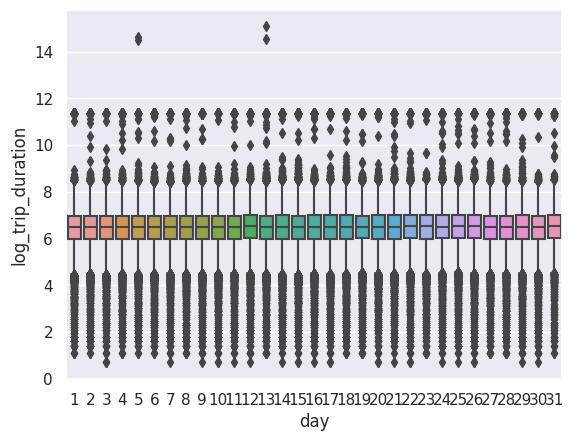

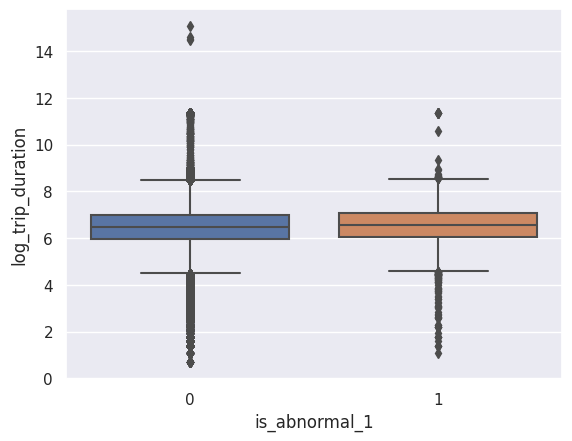

...

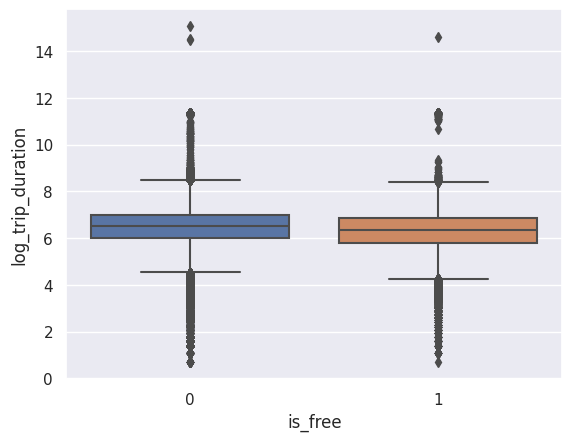

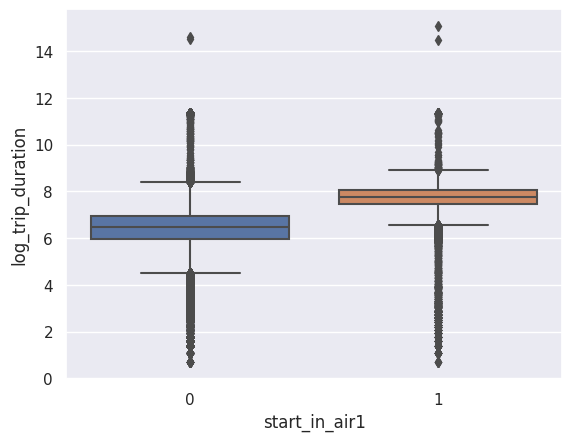

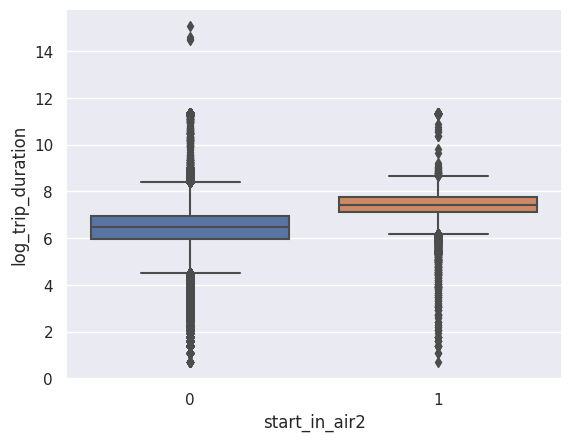

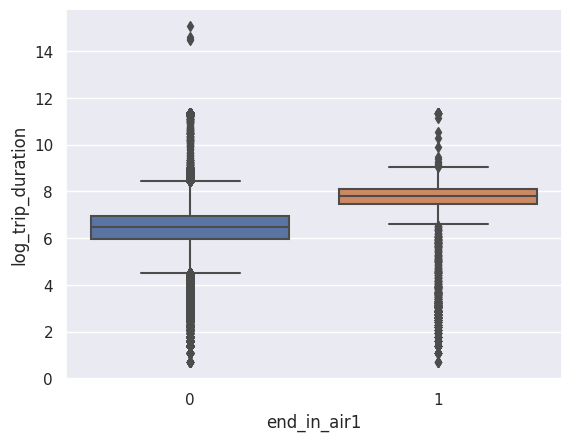

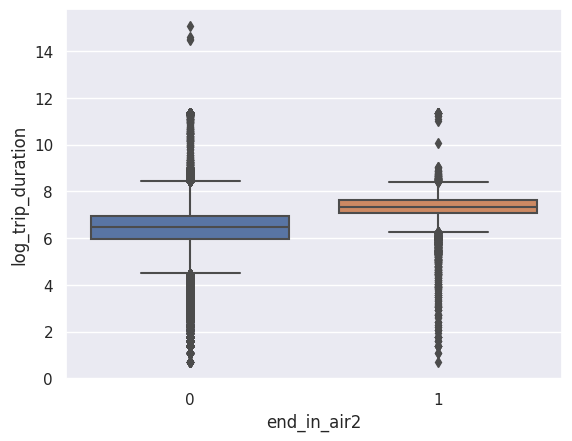

In [78]:
for i in cols:
  plt.figure(i)
  sns.boxplot(x = X_train[i], y = y_train)

**Вопрос**: судя по графикам, как вы думаете, хорошими ли получились эти признаки?

По графикам видно, что признаки о том, началась ли(или закончилась ли) поездка в аэропорте, хорошие. Этот признак скорее всего увеличивает время поездки.
Для остальных признаках распределение почти никак не меняется при разных значениях:(

<img src="https://www.dropbox.com/s/xson9nukz5hba7c/map.png?raw=1" align="right" width="20%" style="margin-left: 20px; margin-bottom: 20px">

**Задание 9 (1 балл)**. Сейчас мы почти что не используем сами значения координат. На это есть несколько причин: по отдельности рассматривать широту и долготу не имеет особого смысла, стоит рассматривать их вместе. Во-вторых, понятно, что зависимость между нашим таргетом и координатами не линейная. Чтобы как-то использовать координаты, можно прибегнуть к следующему трюку: обрамим область с наибольшим количеством поездок прямоугольником (как на рисунке). Разобьем этот прямоугольник на ячейки. Каждой точке сопоставим номер ее ячейки, а тем точкам, что не попали ни в одну из ячеек, сопоставим значение -1.

Напишите трансформер, который сначала разбивает показанную на рисунке область на ячейки, а затем создает два признака: номер ячейки, в которой началась поездка, и номер ячейки, в которой закончилась поездка. Количество строк и столбцов выберите самостоятельно.

Обратите внимание, что все вычисления должны быть векторизованными, трансформер не должен модифицировать передаваемую ему выборку inplace, а все необходимые статистики (если они вдруг нужны) нужно считать только по обучающей выборке в методе `fit`:

In [79]:
# from sklearn.base import BaseEstimator, TransformerMixin

# class MapGridTransformer(BaseEstimator, TransformerMixin):
#     def __init__(self):
#         self.areas = []

#     def fit(self, X, y = None):
#         self.left_lat = X['pickup_latitude'].quantile(0.04)
#         self.right_lat = X['pickup_latitude'].quantile(0.98)

#         self.left_long = X_train['pickup_longitude'].quantile(0.001)
#         self.right_long = X_train['pickup_longitude'].quantile(0.94)

#         self.t_lat = (self.right_lat-self.left_lat)/6
#         self.t_lng = (self.right_long - self.left_long)/4

#         points = []

#         for i in range(7):
#           for j in range(5):
#               points.append((self.left_lat + i* self.t_lat, self.left_long + j * self.t_lng))

#         points = np.array(points).reshape(7,5,2)

#         num = 0
#         for i in range(6):
#           for j in range(4):
#             self.areas.append([points[i,j,:], points[i+1,j,:], points[i,j+1,:], points[i+1,j+1,:]])
#             num+=1

#         return self

#     def get_number(self, obj):
#       number = -1
#       for i, area in enumerate(self.areas):
#         if obj[0] > area[0][0] and obj[0] < area[1][0] and obj[1] > area[0][1] and obj[1] < area[2][1]:
#           number = i
#           break
#       return number

#     def transform(self, X):
#       X_ = X.copy()
#       ans = []
#       for i, row in X[['pickup_latitude', 'pickup_longitude']].iterrows():
#         ans.append(self.get_number(row))
      
#       X_['area_num'] = ans

#       X_ = X_.drop(['pickup_latitude', 'pickup_longitude'], axis = 1)

#       return X_

#     def show_map(self):
#         location = (self.areas[0][0][0], self.areas[0][0][1])
#         m = folium.Map(location=location)
#         for area in self.areas:
#             folium.Rectangle(bounds = area, color = 'red' ).add_to(m)
#         return m

In [80]:
# check = X_train.sample(1000)

In [81]:
# tr = MapGridTransformer()
# ans = tr.fit_transform(check)
# tr.show_map()

In [82]:
borders = ( (40.704214, 40.776463), (-74.019354, -73.942950) ) #google maps
borders_data = [(borders[0][0], borders[1][0]), 
                (borders[0][0], borders[1][1]), 
                (borders[0][1], borders[1][0]), 
                (borders[0][1], borders[1][1])
               ]

In [83]:
show_circles_on_map(pd.DataFrame(borders_data * 1000), 0, 1, "darkgreen")

In [84]:
# оптимальный вариант (без циклов+ненужной функции)
from sklearn.base import BaseEstimator, TransformerMixin

class MapGridTransformer(BaseEstimator, TransformerMixin):
    def __init__(self, rows_numb, cols_numb):
        self.rows = rows_numb
        self.cols = cols_numb
    
    def fit(self, X, y=None):
        return self
    
    def transform(self, X):
        X_new = X.copy()
        
        pickup_in_grid_latitude = (borders[0][0] <= X_new.pickup_latitude) & (X_new.pickup_latitude <= borders[0][1])
        pickup_in_grid_longitude = (borders[1][0] <= X_new.pickup_longitude) & (X_new.pickup_longitude <= borders[1][1])
        pickup_in_grid = pickup_in_grid_latitude & pickup_in_grid_longitude
        
        dropoff_in_grid_latitude = (borders[0][0] <= X_new.dropoff_latitude) & (X_new.dropoff_latitude <= borders[0][1])
        dropoff_in_grid_longitude = (borders[1][0] <= X_new.dropoff_longitude) & (X_new.dropoff_longitude <= borders[1][1])
        dropoff_in_grid = dropoff_in_grid_latitude & dropoff_in_grid_longitude
        
        X_new['pickup_grid'] = -1
        X_new['dropoff_grid'] = -1
        
        for ptype in ['pickup', 'dropoff']:
            in_grid = pickup_in_grid if ptype == 'pickup' else dropoff_in_grid 
            X_new['x_box'] = -1
            X_new['y_box'] = -1
            delta_x = borders[0][1] - borders[0][0]
            delta_y = borders[1][1] - borders[1][0]
            
            #максимальное i <= x.
            X_new.loc[in_grid, 'x_box'] = np.floor((X_new.loc[in_grid, f'{ptype}_latitude'] - borders[0][0]) * self.cols / delta_x).astype('int64')
            X_new.loc[in_grid, 'y_box'] = np.floor((X_new.loc[in_grid, f'{ptype}_longitude'] - borders[1][0]) * self.rows / delta_y).astype('int64')
            X_new.loc[in_grid, f'{ptype}_grid'] = X_new.x_box * self.cols + X_new.y_box
        
        X_new.drop('x_box', axis=1, inplace=True)
        X_new.drop('y_box', axis=1, inplace=True)
        
        return X_new

In [85]:
tr = MapGridTransformer(10,10)
result = tr.transform(X_train)

In [86]:
result['dropoff_grid'].value_counts()

dropoff_grid
-1     274978
 65     34183
 63     33843
 75     30696
 76     28620
        ...  
 70         2
 40         1
 60         1
 92         1
 80         1
Name: count, Length: 97, dtype: int64

**Задание 10 (0.25 балла)**. Обучите `Ridge`-регрессию со стандартными параметрами на признаках, которые мы выделили к текущему моменту. Категориальные признаки закодируйте через one-hot-кодирование, числовые признаки отмасштабируйте.

In [87]:
categorical = ['day_of_week', 'hour', 'month', 'is_abnormal_1', 'is_abnormal_2',
               'is_jam', 'is_free', 'start_in_air1', 'end_in_air1', 'start_in_air2', 'end_in_air2', 'pickup_grid', 'dropoff_grid']
numeric_features = ['days_from_first', 'log_distance_haversine']

In [88]:
features = categorical + numeric_features#+ ['pickup_longitude', 'pickup_latitude', 'dropoff_longitude', 'dropoff_latitude']

In [89]:
class ClearFeaturesTransformer(BaseEstimator, TransformerMixin):
    def __init__(self, feature_list):
        self.features = feature_list
    
    def fit(self, X, y=None):
        return self
    
    def transform(self, X):
        X_new = X.copy()
        
        for column in X.columns:
            if column not in self.features:
                X_new.drop(column, axis=1, inplace=True)
        
        return X_new

In [90]:
column_transformer = ColumnTransformer([
    ('ohe', OneHotEncoder(handle_unknown="ignore"), categorical),
    ('scaling', StandardScaler(), numeric_features)
])

pipeline = Pipeline(steps=[
    ('grid_features', MapGridTransformer(25,25)),
    ('clear_features', ClearFeaturesTransformer(features)),
    ('ohe_and_scaling', column_transformer),
    ('regression', linear_model.Ridge())
])

In [91]:
model_2 = pipeline.fit(X_train, y_train)

In [92]:
y_pred_2 = model_2.predict(X_test)

In [93]:
print(mean_squared_error(y_pred_2, y_test, squared=False))

0.47032817144093597


## Часть 3. Изучаем оставшиеся признаки (1 балл)

**Задание 11 (0.75 баллов)**. У нас осталось еще 3 признака, которые мы не исследовали: `vendor_id`, `passenger_count` и `store_and_fwd_flag`.

**Вопрос**: Подумайте, почему каждый из этих признаков может быть потенциально полезным.

Посчитайте, сколько есть уникальных значений у каждого из этих признаков:

In [94]:
print(X_train['vendor_id'].nunique(), X_train['passenger_count'].nunique(), X_train['store_and_fwd_flag'].nunique())

2 10 2


Постройте "ящики с усами" распределений логарифма времени поездки в зависимости от значений каждого из признаков

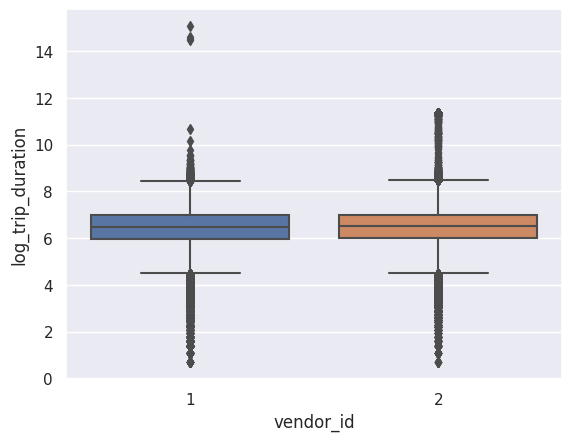

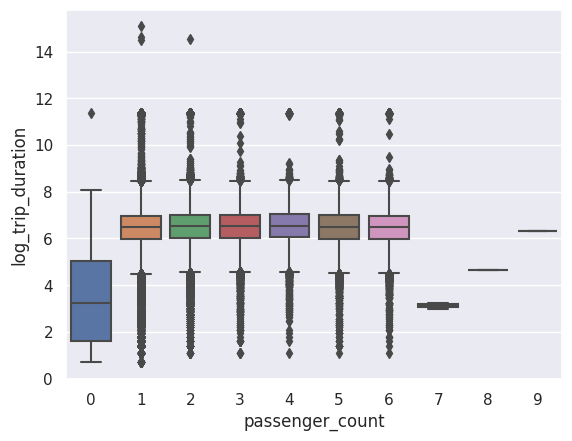

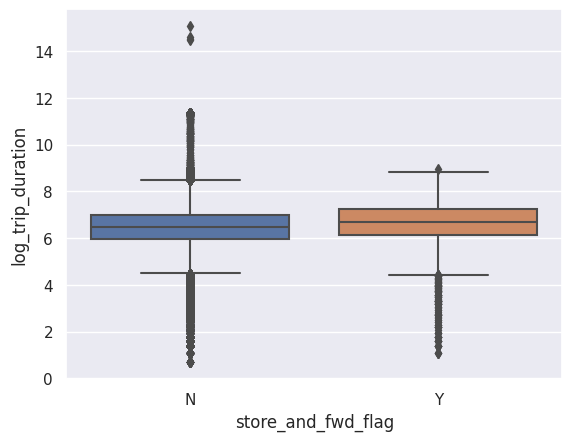

In [95]:
cols = ['vendor_id', 'passenger_count', 'store_and_fwd_flag']
for i in cols:
  plt.figure(i)
  sns.boxplot(x = X_train[i], y = y_train)

Переведите признаки `vendor_id` и `store_and_fwd_flag` в значения $\{0;1\}$

In [96]:
X_train['vendor_id'] = X_train['vendor_id'].apply(lambda x: 0 if x==2 else x)
X_test['vendor_id'] = X_test['vendor_id'].apply(lambda x: 0 if x==2 else x)

In [97]:
X_train['store_and_fwd_flag'] = X_train['store_and_fwd_flag'].apply(lambda x: 0 if x=='N' else 1)
X_test['store_and_fwd_flag'] = X_test['store_and_fwd_flag'].apply(lambda x: 0 if x=='N' else 1)

**Вопрос**: Основываясь на графиках выше, как вы думаете, будут ли эти признаки сильными?

только если Passenger_count

**Задание 12 (0.25 баллов)**. Проверьте свои предположения, обучив модель в том числе и на этих трех признаках. Обучайте `Ridge`-регрессию со стандартными параметрами. Категориальные признаки закодируйте one-hot-кодированием, а численные отмасштабируйте.

In [98]:
categorical = categorical + cols
features = features + cols

In [99]:
column_transformer = ColumnTransformer([
    ('ohe', OneHotEncoder(handle_unknown="ignore"), categorical),
    ('scaling', StandardScaler(), numeric_features)
])

pipeline = Pipeline(steps=[
    ('grid_features', MapGridTransformer(25,25)),
    ('clear_features', ClearFeaturesTransformer(features)),
    ('ohe_and_scaling', column_transformer),
    ('regression', linear_model.Ridge())
])

In [100]:
model_3 = pipeline.fit(X_train, y_train)

In [101]:
y_pred_3 = model_3.predict(X_test)

In [102]:
print(mean_squared_error(y_pred_3, y_test, squared=False))

0.469923994877665


Если признаки не дали какого-то ощутимого улучшения метрики, их можно выбросить из данных.

In [103]:
X_train.drop(columns = ['id', 'vendor_id', 'passenger_count', 'store_and_fwd_flag'], inplace=True)
X_test.drop(columns = ['id', 'vendor_id', 'passenger_count', 'store_and_fwd_flag'], inplace=True)

In [104]:
categorical = list(set(categorical).difference(set(['vendor_id', 'passenger_count', 'store_and_fwd_flag'])))
features = list(set(features).difference(set(['vendor_id', 'passenger_count', 'store_and_fwd_flag'])))

## Часть 4. Улучшаем модель (3 балла)

**Задание 13 (1 балл)**. В наших данных есть нетипичные объекты (выбросы, или outliers): с аномально маленьким времени поездки, с очень большим пройденным расстоянием или очень большими остатками регрессии. В этом задании предлагается исключить такие объекты из обучающей выборки. Для этого нарисуйте гистограммы распределения упомянутых выше величин, выберите объекты, которые можно назвать выбросами, и очистите __обучающую выборку__ от них.

Отметим, что хотя эти объекты и выглядят как выбросы, в тестовой выборке тоже скорее всего будут объекты с такими же странными значениями целевой переменной и/или признаков. Поэтому, возможно, чистка обучающей выборки приведёт к ухудшению качества на тесте. Тем не менее, всё равно лучше удалять выбросы из обучения, чтобы модель получалась более разумной и интерпретируемой.

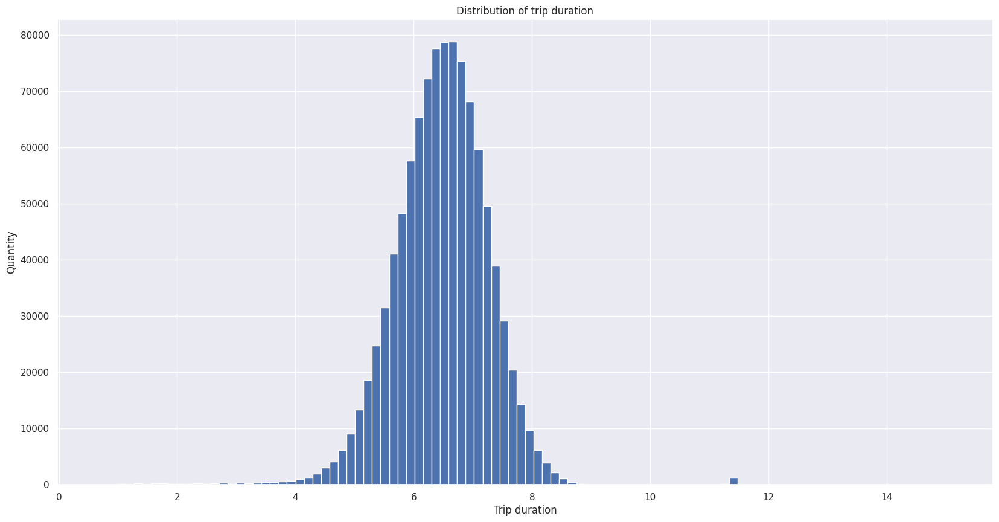

In [105]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(20,10))

ax.set_title('Distribution of trip duration')
ax.set_ylabel('Quantity')
ax.set_xlabel('Trip duration')

ax.hist(y_train, bins=100)
plt.show()

In [106]:
(y_train < y_train.quantile(0.995)) & (y_train > y_train.quantile(0.005))

1011257    True
178550     True
551460     True
1434271    True
1173610    True
           ... 
259178     True
1414414    True
131932     True
671155     True
121958     True
Name: log_trip_duration, Length: 1021050, dtype: bool

In [107]:
X_train = X_train[(y_train < y_train.quantile(0.995)) & (y_train > y_train.quantile(0.005))]
y_train = y_train[(y_train < y_train.quantile(0.995)) & (y_train > y_train.quantile(0.005))]

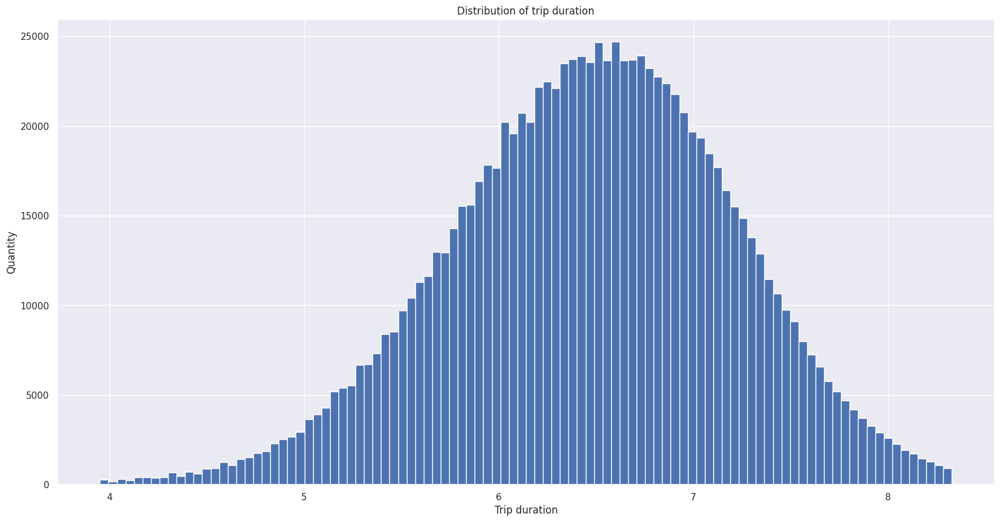

In [108]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(20,10))

ax.set_title('Distribution of trip duration')
ax.set_ylabel('Quantity')
ax.set_xlabel('Trip duration')

ax.hist(y_train, bins=100)
plt.show()

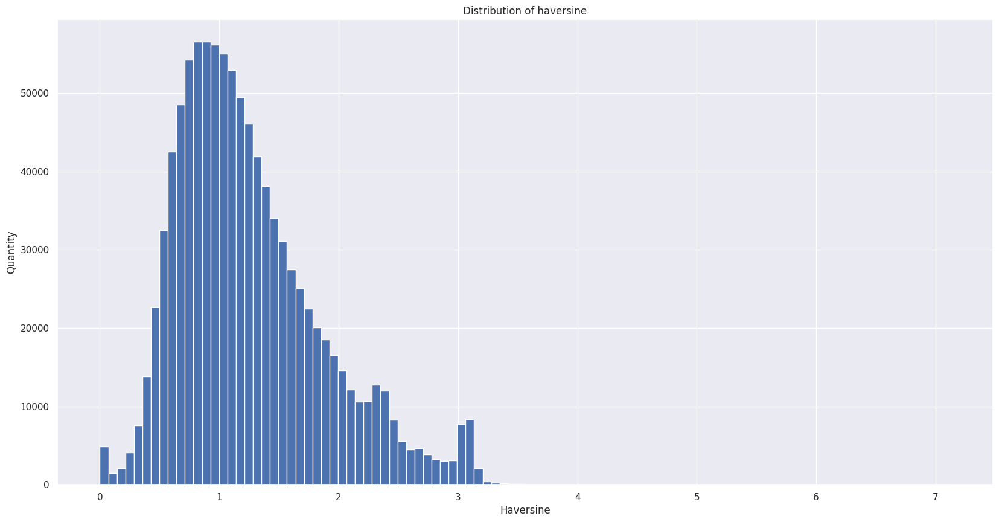

In [109]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(20,10))

ax.set_title('Distribution of haversine')
ax.set_ylabel('Quantity')
ax.set_xlabel('Haversine')

ax.hist(X_train['log_distance_haversine'], bins=100)
plt.show()

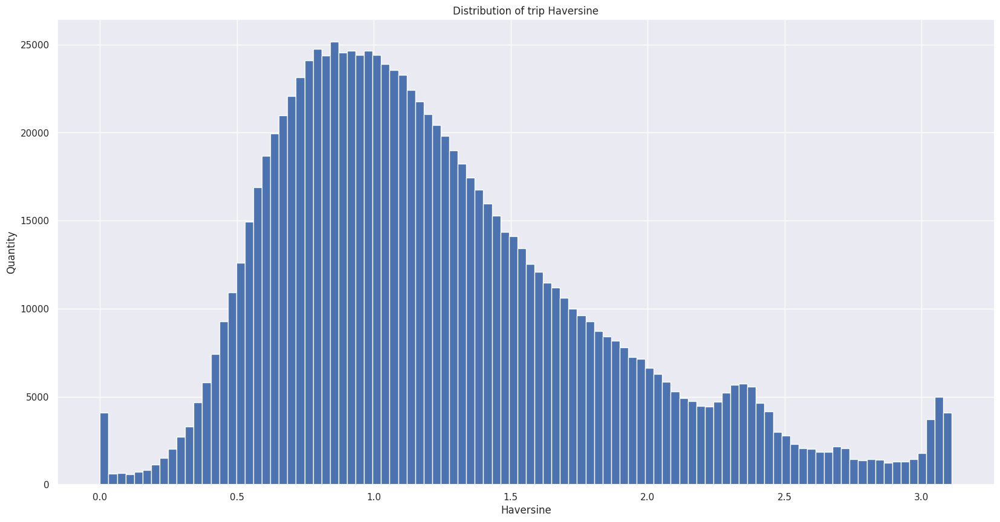

In [110]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(20,10))

ax.set_title('Distribution of trip Haversine')
ax.set_ylabel('Quantity')
ax.set_xlabel('Haversine')

ax.hist(X_train['log_distance_haversine'][X_train['log_distance_haversine'] < X_train['log_distance_haversine'].quantile(0.995)], bins=100)
plt.show()

In [111]:
y_train = y_train[X_train['log_distance_haversine'] < X_train['log_distance_haversine'].quantile(0.995)]
X_train = X_train[X_train['log_distance_haversine'] < X_train['log_distance_haversine'].quantile(0.995)]

In [112]:
# Теперь посчитаем предсказание модели на оставшихся данных и отсечем 0.5% лишних данных
column_transformer = ColumnTransformer([
    ('ohe', OneHotEncoder(handle_unknown="ignore"), categorical),
    ('scaling', StandardScaler(), numeric_features)
])

pipeline = Pipeline(steps=[
    ('grid_features', MapGridTransformer(25,25)),
    ('clear_features', ClearFeaturesTransformer(features)),
    ('ohe_and_scaling', column_transformer),
    ('regression', linear_model.Ridge())
])
model = pipeline.fit(X_train, y_train)

y_pred = model.predict(X_train)
delta_regression = (y_train - y_pred)**2

In [113]:
X_train = X_train[delta_regression < delta_regression.quantile(0.95)]
y_train = y_train[delta_regression < delta_regression.quantile(0.95)]

Сейчас у нас очень много категориальных признаков. В категориальных признаках могут содержаться редкие категории, обычно это плохо: модель сильно переобучается на таких примерах. Для каждого категориального признака объедините действительно редкие категории в одну, если такие имеются (т.е. если категории действительно редкие). 

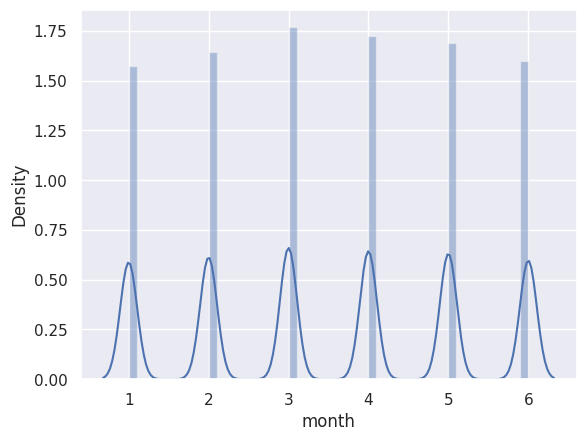

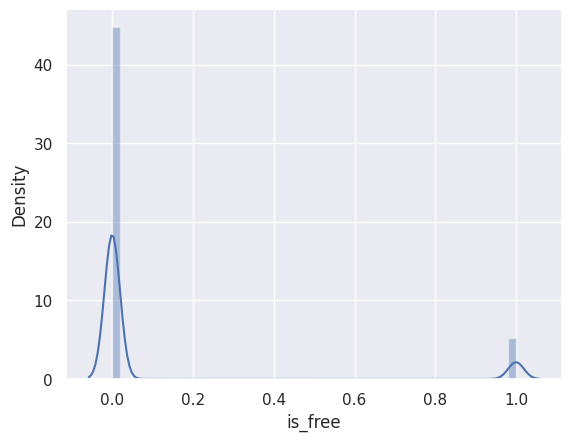

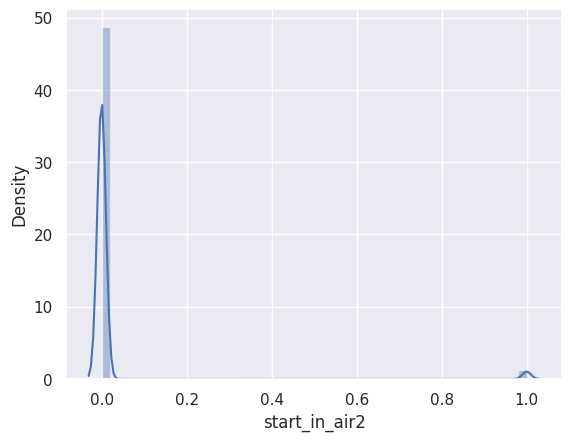

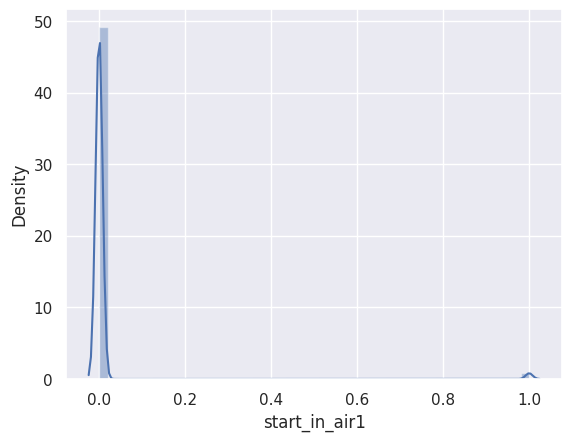

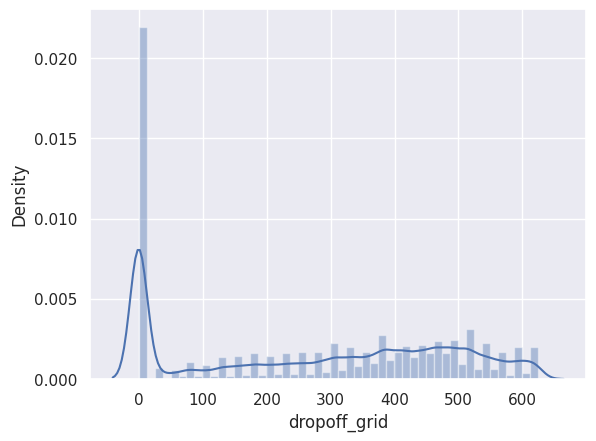

...

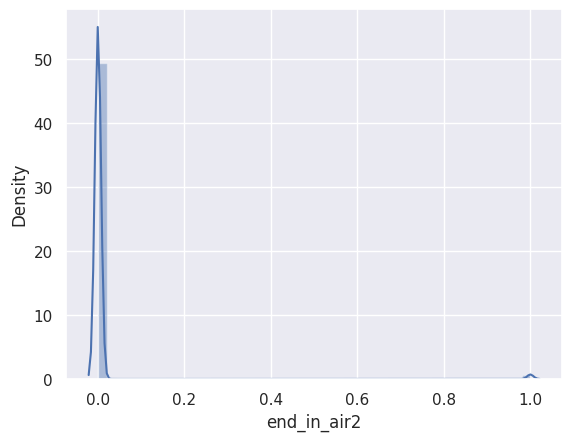

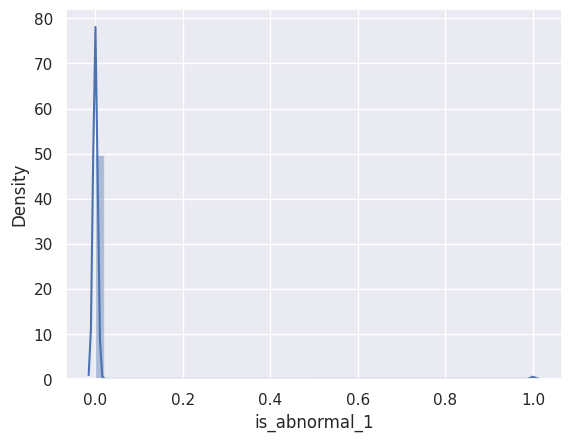

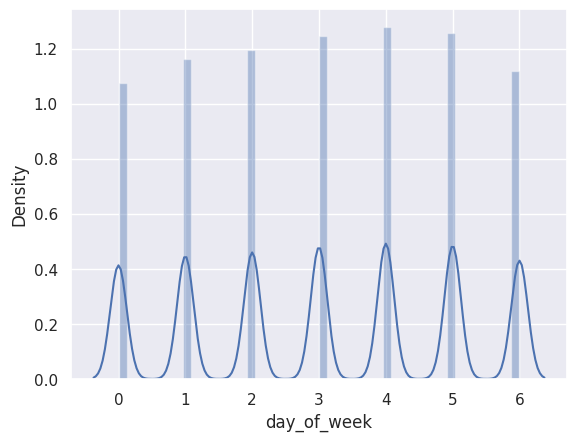

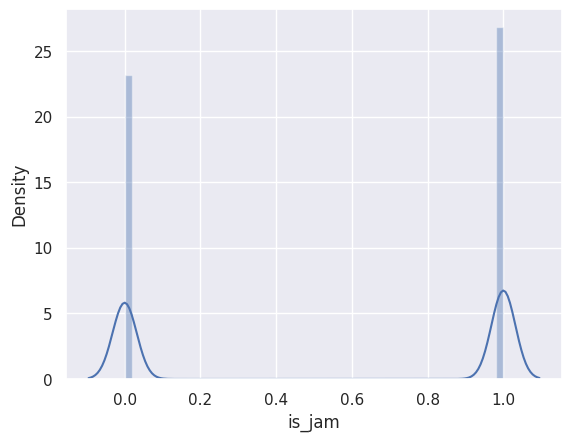

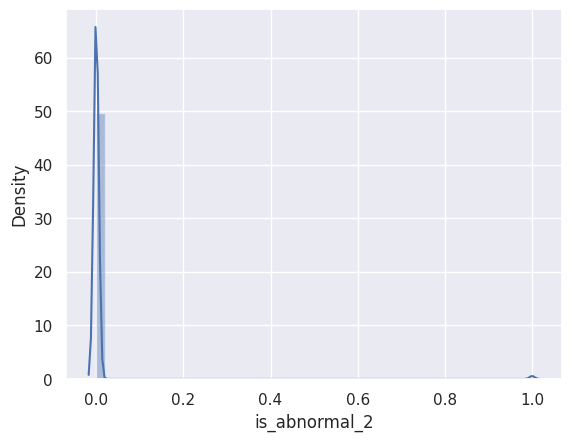

In [114]:
# гистограммы по категориальным признакам
import warnings
warnings.simplefilter("ignore", UserWarning)
for feature in categorical:
    transformer = MapGridTransformer(25,25)
    sns.distplot(transformer.transform(X_train)[feature])
    plt.show()

вроде все ок, хотя можно было объединить часы 

Обучите модель на очищенных данных и посчитайте качество на тестовой выборке.

In [115]:
column_transformer = ColumnTransformer([
    ('ohe', OneHotEncoder(handle_unknown="ignore"), categorical),
    ('scaling', StandardScaler(), numeric_features)
])

pipeline = Pipeline(steps=[
    ('grid_features', MapGridTransformer(25,25)),
    ('clear_features', ClearFeaturesTransformer(features)),
    ('ohe_and_scaling', column_transformer),
    ('regression', linear_model.Ridge())
])
model = pipeline.fit(X_train, y_train)
y_pred = model.predict(X_test)
print(mean_squared_error(y_pred, y_test, squared=False))

0.4710333613068154


**Задание 14 (1 балл)**. После OneHot-кодирования количество признаков в нашем датасете сильно возрастает. Посчитайте колиество признаков до и после кодирования категориальных признаков.

In [116]:
pipeline_transform = Pipeline(steps=[
    ('grid_features', MapGridTransformer(25,25)),
    ('clear_features', ClearFeaturesTransformer(features)),
    ('ohe_and_scaling', column_transformer)
])

In [117]:
print("было:", X_train.shape)
print("стало:", pipeline_transform.transform(X_train).shape)

было: (955435, 24)
стало: (955435, 1058)


In [118]:
print(25*25, 'фичей добавляет мапгрид')

625 фичей добавляет мапгрид


Попробуйте обучить не `Ridge`-, а `Lasso`-регрессию. Какой метод лучше?

In [119]:
column_transformer = ColumnTransformer([
    ('ohe', OneHotEncoder(handle_unknown="ignore"), categorical),
    ('scaling', StandardScaler(), numeric_features)
])

pipeline = Pipeline(steps=[
    ('grid_features', MapGridTransformer(25,25)),
    ('clear_features', ClearFeaturesTransformer(features)),
    ('ohe_and_scaling', column_transformer),
    ('regression', linear_model.Lasso())
])
model = pipeline.fit(X_train, y_train)
y_pred = model.predict(X_test)
print('MSE:', mean_squared_error(y_pred, y_test, squared=False))

MSE: 0.7953230173839113


результат хуже

Разбейте _обучающую выборку_ на обучающую и валидационную в отношении 8:2. По валидационной выборке подберите оптимальные значения параметра регуляризации (по логарифмической сетке) для `Ridge` и `Lasso`, на тестовой выборке измерьте качество лучшей полученной модели.

In [120]:
X_train_train, X_valid, y_train_train, y_valid = train_test_split(X_train, y_train, test_size=0.2, random_state=42)

X_train_transformed = pipeline_transform.transform(X_train_train)
X_valid_transformed = pipeline_transform.transform(X_valid)

In [121]:
np.logspace(-5, 3, 15)

array([1.00000000e-05, 3.72759372e-05, 1.38949549e-04, 5.17947468e-04,
       1.93069773e-03, 7.19685673e-03, 2.68269580e-02, 1.00000000e-01,
       3.72759372e-01, 1.38949549e+00, 5.17947468e+00, 1.93069773e+01,
       7.19685673e+01, 2.68269580e+02, 1.00000000e+03])

In [ ]:
from tqdm import tqdm
alphas = np.logspace(-5, 3, 15)
result = []
zero_weights = []

for alpha in tqdm(alphas):
    model = linear_model.Lasso(alpha).fit(X_train_transformed, y_train_train)
    result.append(mean_squared_error(model.predict(X_valid_transformed), y_valid, squared=False))
    zero_weights.append(sum([coef == 0 for coef in model.coef_]))
    break

plt.plot(alphas, result)
plt.xscale("log")
plt.xlabel("alpha")
plt.ylabel("Score")

  0%|                                                    | 0/15 [00:00<?, ?it/s]

1


In [ ]:
#не дождался(

Для каждого перебранного `alpha` для Lasso посчитайте количество нулевых весов в модели и нарисуйте график зависимости его от `alpha`. Как сильно придётся потерять в качестве, если мы хотим с помощью Lasso избавиться хотя бы от половины признаков?

In [ ]:
plt.plot(alphas, zero_weights)
plt.xscale("log")
plt.xlabel("alpha")
plt.ylabel("zero weights")

<img src="https://www.dropbox.com/s/wp4jj0599np17lh/map_direction.png?raw=1" width="20%" align="right" style="margin-left: 20px">

**Задание 15 (1 балл)**. Часто бывает полезным использовать взаимодействия признаков (feature interactions), то есть строить новые признаки на основе уже существующих. Выше мы разбили карту Манхэттена на ячейки и придумали признаки "из какой ячейки началась поездка" и "в какой ячейке закончилась поездка".

Давайте попробуем сделать следующее: посчитаем, сколько раз встречается каждая возможная пара этих признаков в нашем датасете и выберем 100 самых частых пар. Закодируем поездки с этими частыми парами как категориальный признак, остальным объектам припишем -1. Получается, что мы закодировали, откуда и куда должно было ехать такси.

Также можете придумать ещё какой-нибудь способ сделать признаки про маршрут. Если эти признаки будут давать хороший прирост в качестве, то за это могут быть даны дополнительные бонусные баллы.

**Вопрос**: Почему такой признак потенциально полезный? Почему линейная модель не может самостоятельно "вытащить" эту информацию, ведь у нее в распоряжении есть признаки "из какой ячейки началась поездка" и "в какой ячейке закончилась поездка"?

In [ ]:
#╰( ͡° ͜ʖ ͡° )つ──☆*:・ﾟ

Заново обучите модель (`Ridge`, если она дала более высокое качество в предыдущих экспериментах, и `Lasso` иначе) на новых даннных и посчитайте качество на тестовой выборке

In [ ]:
#╰( ͡° ͜ʖ ͡° )つ──☆*:・ﾟ

**Задание 16 (бонус, 1 балл)**. Где, как не для нашей задачи, считать манхэттенское расстояние?

**Вопрос**: Найдите, что такое манхэттенское расстояние и почему оно так называется. Как оно нам может помочь?

Введите систему координат на нашей карте так, чтобы оси были параллельны улицам Манхэттена, и добавьте сначала в данные признак "манхэттенское расстояние между пунктом отправления и пунктом назначения", а затем и логарифм этого признака. Посчитайте корреляцию между вашим новыми признаком и таргетом; между `log_haversine` и таргетом. В каком случае корреляция больше?

Нарисуйте карту, где покажете выбранные оси. Чтобы мы могли проверить вашу работу, просьба сделать скрин этой карты и приложить картинку (если мы откроем ваш ноутбук, виджеты отображаться не будут). 

In [ ]:
#╰( ͡° ͜ʖ ͡° )つ──☆*:・ﾟ

Заново обучите модель на новых даннных и посчитайте качество на тестовой выборке. Стало ли лучше? Объясните полученный результат.

In [ ]:
#╰( ͡° ͜ʖ ͡° )つ──☆*:・ﾟ

**Задание 17 (бонус, 2 балла)**. Реализуйте трансформер, который строит разбиение карты по шестигранной решётке с помощью библиотеки [H3](https://github.com/uber/h3-py) и вычисляет признаки на основе такого разбиения.

Признаки могут быть самые разные: расстояние между точкой старта и финиша, посчитанное в количестве шестиугольников; статистика по числу поездок и по их продолжительности в соседних шестиугольниках.

Важно: производительность библиотеки существенно зависит от количества шестиугольников на карте (определяется параметром resolution). Подберите такое разрешение, при котором ваш код будет работать за приемлемое время.

При построении признаков старайтесь не допустить утечки целевой переменной (подробнее про это можно почитать в материалах 1-го семинара) — в противном случае хорошего качества на тестовой выборке достичь не получится.

Измерьте качество после добавления новых признаков. За улучшение функционала ошибки на каждые 0.005 на тестовой выборке будет даваться 0.5 бонусных балла. Можно получить до 2 бонусных баллов за это задание.

In [ ]:
#╰( ͡° ͜ʖ ͡° )つ──☆*:・ﾟ

Вставьте картинку, описывающую ваш опыт выполнения этого ДЗ.